## The Sugarscape.

The "Sugarscape" is a landscape (in the form of a lattice) where **sugar grows in each cell**.

The sugar provides energy and wealth.

**Agents explore the landscape** and, while doing it, harvest the sugar. 

- Each round, each agent move once. They move sequentially. Each round, the order in which the agent move is random.

- Two agents can't share the same cell: if an agent can't move on a free cell within its range, it remains in the cell it occupies.

- Each agent pays a metabilic cost to remain alive and move on the sugarscape. When their energy (that corresponds to their sugar level) falls below zero then they die of starvation.

At the end of each round, the **landscape regrowth the sugar** according to the growth rule $G_{\rm g}$.

For more details: see the book, page 16-5 and on.

### Features of the Sugarscape.

We start from the classical implementation: 

- squared lattice $N \times N$

- sugar full capacity of each cell: from 0 to 4

- landscape shaped like two sugar-hills

- rule $G_{\infty}$: at the end of each round, the sugar regrowth instantly to the maximum capacity of each cell.

### Agents on the Sugarscape.

Agents on sugarsape have the following features:

- vision: $v$ (uniform distribution $\in \{1, 2, ..., 6 \}$)
- sugar: $s$ (uniform distribution $\in \{5, 6, ... 25 \}$)
- metabolism: $m$ (uniform distribution $\in \{1, 2, 3, 4 \}$)

The vision determines the motion range.

The sugar is a reservoir of energy.

In [1]:
import numpy as np

In [2]:
def move_agents(SuSca, N_alive, genes, x, y, pol_region):
    """
    Function to move the agents on the sugarscape.
    Implements one round where all the agents move once.
    
    Parameters
    ==========
    SuSca : Lattice representing the Sugarscape. 
    N_alive : Number of alive agents.
    genes : V, S, M
    V : Vision. 1-d numpy array.
    S : Sugar. 1-d numpy array.
    M : Metabolism. 1-d numpy array.
    x : x-position on the lattice of the agents. 1-d numpy array.
    y : y-position on the lattice of the agents. 1-d numpy array.
    pol_region : The subarray of the SuSca lattice representing polluted areas.
    """
    
    Nx, Ny = SuSca.shape
    
    nSuSca = SuSca.copy()
    nx = x.copy()
    ny = y.copy()
    nS = genes[2].copy()
    
    # Define the order of the agents in this round.   
    order = np.random.permutation(N_alive)
    
    # For each agent: move it in the range of the vision.
    
    for na in range(N_alive):
        ia = order[na]
        # Agent current position.
        xa = nx[ia]
        ya = ny[ia]
        va = genes[0][ia]  # Vision.
        sa = genes[1][ia]  # Available sugar/energy amount.
        ma = genes[2][ia]  # Metabolic rate.

        # Cells within the range of the agent.
        rx = np.zeros(va * 4 + 1) + xa
        ry = np.zeros(va * 4 + 1) + ya
        rx[0] = xa
        ry[0] = ya
        rx[0 * va + 1:1 * va + 1] = xa + np.arange(va) + 1
        rx[1 * va + 1:2 * va + 1] = xa - np.arange(va) - 1
        ry[2 * va + 1:3 * va + 1] = ya + np.arange(va) + 1
        ry[3 * va + 1:4 * va + 1] = ya - np.arange(va) - 1
        rx = rx.astype(int) % Nx
        ry = ry.astype(int) % Ny

        sugar = nSuSca[rx, ry]        
        max_sugar = np.amax(sugar)
        searching_new_pos = True
        sugar_level = int(max_sugar)
        
        # Agent looks for the best available position.
        while searching_new_pos:
            # Search options for a certain sugar level.
            options = np.where(sugar == sugar_level)[0]
            
            # For each option, check whether position is already occupied.            
            io = 0
            place_found = False
            while (io < np.size(options)) and (not place_found):
                i = options[io]
                x_ref = rx[i] % Nx
                y_ref = ry[i] % Ny
                # Check if the position is available.
                a_ref = np.intersect1d(
                    np.where(nx == x_ref)[0],
                    np.where(ny == y_ref)[0])
                if np.size(a_ref) == 0:
                    # Position is available
                    nx[na] = x_ref 
                    ny[na] = y_ref
                    nS[na] += nSuSca[x_ref, y_ref]  # Agent takes the sugar.
                    nSuSca[x_ref, y_ref] = 0   # Sugarscape cell is depleted.
                    place_found = True
                else:
                    # Check whether this is the current position.
                    if (x_ref == nx[na]) and (y_ref == ny[na]):
                        nS[na] += nSuSca[x_ref, y_ref]  # Agent takes the sugar.
                        nSuSca[x_ref, y_ref] = 0   # Sugarscape cell is depleted.
                        place_found = True
                    else:
                        # The position is occupied by someone else.
                        io += 1
            
            # If we are here, we either have found a place or 
            # exausted the possibilities for this sugar_level
            
            if not place_found:
                if sugar_level > 0:
                    sugar_level -= 1
                else:
                    # The agent stays where it is.                    
                    nS[na] += nSuSca[nx[na], ny[na]]  # Agent takes the sugar.
                    nSuSca[nx[na], ny[na]] = 0
                    #print(nx[na], ny[na])
                    #print(pol_region)
                    if nx[na] in pol_region[0] and ny[na] in pol_region[0]:
                        if va == 0:
                            searching_new_pos = False
                        else:
                            va = va-1
#                        genes[2] = genes[2]*0.99
                    searching_new_pos = False
            else: 
                # A place has been found for the agent.
                #print(nx[na], ny[na])
                #print(pol_region)
                if nx[na] in pol_region[0] and ny[na] in pol_region[0]:
                    if va == 0:
                        searching_new_pos = False
                    else:
                        va = va-1
#                    genes[2] = genes[2]-1
                searching_new_pos = False
        
    
    # All agents have moved.
    
    # Now pay the metabolic price.
    nS = nS - genes[2] # S - M
    
    # Now check which agents are still alive.
    still_alive = np.where(nS > 0)[0]
    
    N_still_alive = np.size(still_alive)
    V_alive = genes[0][still_alive]
    S_alive = nS[still_alive]
    M_alive = genes[2][still_alive]
    x_alive = nx[still_alive]
    y_alive = ny[still_alive]
        
    return nSuSca, N_still_alive, V_alive, S_alive, M_alive, x_alive, y_alive




# Initalize the sugarscape in a "classical way"

In [3]:
def initialize_sugarscape(N, sugar_centers):
    """
    Function to generate the "classical" sugarscape.
    
    Parameters
    ==========
    N : Side of the sugarscape lattice.
    sugar_centers : Coordinates for sugar hill peaks [0]=x, [1]=y
    pol_centers : Coordinates for pollution hill peaks
    """
    
    SuSca = np.zeros([N, N])
    X, Y = np.meshgrid(np.arange(N), np.arange(N))
    
    x_centers_s = np.array(sugar_centers[0]) # 
    y_centers_s = np.array(sugar_centers[1]) # 

    r_levels_s = np.array([4, 3, 2, 1]) / 4 * (np.sqrt(2) / 4) * N # Radius sizes for the level curves of sugar areas
    s_levels_s = np.array([1, 2, 3, 4]) # sugar levels at each level curve

    updated_mask = np.zeros_like(SuSca, dtype=bool)
    
    for k in range(np.size(x_centers_s)):
        d = np.sqrt((X - x_centers_s[k]) ** 2 +
                    (Y - y_centers_s[k]) ** 2)
        for i in range(np.size(s_levels_s)):
            region = np.where(d <= r_levels_s[i])
            # Combine values in overlapping regions

            # Create a boolean mask for the region
            region_mask = np.zeros_like(SuSca, dtype=bool)
            region_mask[region] = True
            
            # Overlapping areas: Combine values
            overlapping_mask = region_mask & updated_mask
            SuSca[overlapping_mask] += s_levels_s[i]
            
            # Non-overlapping areas: Initialize from scratch
            non_overlapping_mask = region_mask & ~updated_mask
            SuSca[non_overlapping_mask] = s_levels_s[i]
            
            # Update the global mask for all processed cells
            updated_mask |= region_mask

    
    return SuSca, x_centers_s, y_centers_s

In [4]:
# Natural disaster
def natural_disaster(SuSca, N, x_centers_s, y_centers_s):
    X, Y = np.meshgrid(np.arange(N), np.arange(N))
    #x_centers_s = np.array([3*N / 4, 3 * N / 4]) # Include the centers of the sugar areas so that our natural disaster happens in an area in which it has some effect

    level_curve = (np.sqrt(2) / 4) * N
    x_center_neg = np.array([np.random.randint(x_centers_s[0]-level_curve, x_centers_s[1]+level_curve)]) 
    y_center_neg = np.array([np.random.randint(y_centers_s[0]-level_curve, y_centers_s[1]+level_curve)]) 

    r_levels_neg = np.array([2, 1]) / 4 * level_curve
    intensity = np.array([np.random.randint(-1, 0), np.random.randint(-4,-2)])

    for i in range(np.size(intensity)):
        d = np.sqrt((X - x_center_neg) ** 2 + (Y - y_center_neg) ** 2)
        region = np.where(d <= r_levels_neg[i])
        SuSca[region[0], region[1]] = SuSca[region[0], region[1]] + intensity[i] # np.maximum(x, 0) for non-negative

    return SuSca

In [5]:
# Pollution areas
def create_pollution_region(SuSca, N, x_centers_s, y_centers_s):
    X, Y = np.meshgrid(np.arange(N), np.arange(N))
    #x_centers_s = np.array([3*N / 4, 3 * N / 4])

    level_curve = (np.sqrt(2) / 4) * N

    x_center_pol = np.array([np.random.randint(x_centers_s[0]-level_curve, x_centers_s[1]+level_curve)]) 
    y_center_pol = np.array([np.random.randint(y_centers_s[0]-level_curve, y_centers_s[1]+level_curve)]) 

    r_levels_pol = np.array([1]) / 4 * level_curve # Radius sizes for level curves of pollution areas
    #impact_level = ['pollution'] # First implementation just add a string
    #impact_level = np.array([3]) # Higher value --> higher negative impact on mutation rate (i.e visibility, metabolism, velocity, etc goes down in current agent)

    # On the impact level. It would be interesting if we could impact the current generation only, but that the kids of those suffer consequences from their parents, i.e 
    # that the children of agents living close by pollution are worse off economically in this model. The children would be "born" when two agents meet and are of different
    # gender (?). We could maybe even seperate the agents by species, so that we can plot how the economy of each bloodline differs over time
    # in order for the agents not to move away from this, their movement shouldn't be affected by the pollution rate, i.e not to be educated about the hazards of pollution

    #for i in range(np.size(impact_level)):
    d = np.sqrt((X - x_center_pol) ** 2 + (Y - y_center_pol) ** 2)
    region = np.where(d <= r_levels_pol[0])
#        SuSca[region[0], region[1]] = SuSca[region[0], region[1]] + impact_level[i] # Jag vill få varje element här att vara elementet självt plus en tag för pollution

    return region

### Function to convert numpy array into image

In [6]:
import sys
def convert2RBG(game_outcome, RGB0, RGB1, RGBNEG, RGBPOL, pol_region):
    """
    Function to convert the 2 dimensional numpy array into a RGB image.
    
    Parameters
    ==========
    game_outcome : Outcome of the prisoner's dilemma.
    RGB0 : Components R, G, B of the chosen color shade for minimum I_profile.
    RGB1 : Components R, G, B of the chosen color shade for maximum I_profile.
    """
    
    [n_rows, n_cols] = game_outcome.shape
    
    I_RGB = np.zeros([n_rows, n_cols, 3])
    
    # Set I_profile between 0 and 1
    min_val = np.amin(game_outcome)
    game_outcome /= np.amax(game_outcome)  


    for c in range(3):
        neg_mask = game_outcome < 0
        I_RGB[:, :, c] = game_outcome * RGB1[c] + (1 - game_outcome) * RGB0[c]
        I_RGB[neg_mask] = I_RGB[neg_mask] * RGBNEG # For showing negative values
        I_RGB[pol_region] = I_RGB[pol_region] * RGBPOL
        
    return I_RGB

### Checking initialization

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.2].


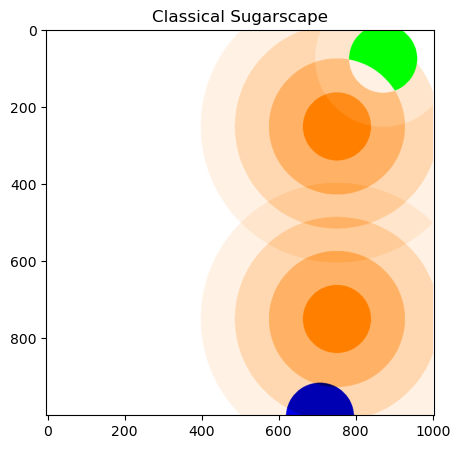

In [7]:
from matplotlib import pyplot as plt

N = 1000  # Side of the sugarscape.

sugar_centers = [3*N / 4, 3 * N / 4], [N / 4, 3 * N / 4]

SuSca, x_centers_s, y_centers_s = initialize_sugarscape(N, sugar_centers) 
SuSca = natural_disaster(SuSca, N, x_centers_s, y_centers_s)
pol_region = create_pollution_region(SuSca, N, x_centers_s, y_centers_s)


# Create the image of the game outcome.
RGB1 = [1.0, 0.5, 0.0]  # Orange. Color for high values.
RGB0 = [1.0, 1.0, 1.0]  # White. Color for low values.
RGBNEG = [0., 1., 0.] # Grön (naturkatastrofer) för negativa värden
RGBPOL = [0., 0., 1.] # Röd (pollution) 

SuSca_RGB = convert2RBG(SuSca, RGB0, RGB1, RGBNEG, RGBPOL, pol_region)

# Plot the Sugarscape.
plt.figure(figsize=(5, 5))
plt.imshow(SuSca_RGB)  # Plot Sugarscape profile.
# Plot the reference points.
plt.title('Classical Sugarscape')
plt.axis('equal')
plt.show()       


In [8]:
from random import sample

N = 50  # Size of the sugarscape with the agents.
A = 400  # Number of agents on the sugarscape.

# Initial values. Chosen from the following flat distributions.
possible_m = np.arange(4) + 1  # Metabolic rate.
possible_v = np.arange(6) + 5  # Vision.
possible_s = np.arange(21) + 5  # Sugar.

# Agents initialized. 
M = np.random.randint(np.size(possible_m), size=A) + 1
V = np.random.randint(np.size(possible_v), size=A) + 1
S = np.random.randint(np.size(possible_s), size=A) + 5

# Define agents position. 
L = np.array(sample(range(N * N), A)).astype(int) 
x = L % N
y = ((L - x) / N).astype(int) 
# This way each agent occupy a different cell.

sugar_centers = [3*N / 4, 3 * N / 4], [N / 4, 3 * N / 4]

SuSca, x_centers_s, y_centers_s = initialize_sugarscape(N, sugar_centers)
SuSca = natural_disaster(SuSca, N, x_centers_s, y_centers_s)
pol_region = create_pollution_region(SuSca, N, x_centers_s, y_centers_s)

In [9]:
import sys
np.set_printoptions(threshold=sys.maxsize)
print(SuSca)

[[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  1.  1.  1.  3.  3.
   3.  3.  3.  3.  3.  3.  1.  1.  1.  1.  1.  1.  1.  1.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  3.  3.  3.  3.  3.
   3.  3.  3.  3.  3.  3.  3.  3.  3.  1.  1.  1.  1.  1.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  3.  3.  3.  3.  3.  3.
   3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  1.  1.  1.  1.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  3.  3.  3.  3.  3.  3.  3.
   3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  3.  1.  1.  1.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  1.  1.  1.  1.  1.  1.  3.  3.  3.  3.  3.  3.  3.  3.
   6.  6.  6.  6.  3.  3

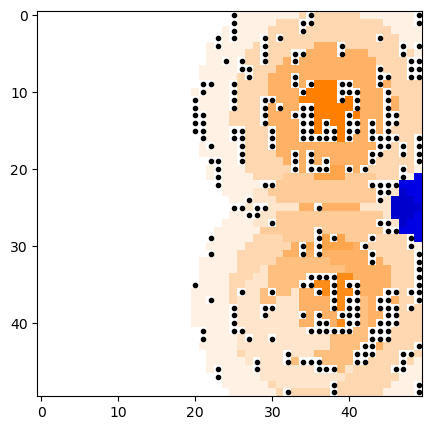

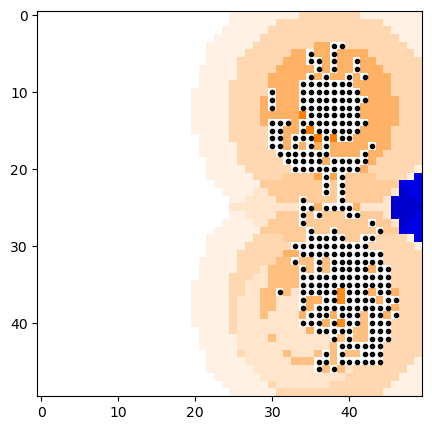

In [ ]:
from IPython.display import clear_output
from matplotlib import pyplot as plt
    
# Create the image of the game outcome.
RGB1 = [1.0, 0.5, 0.0]  # Orange. Color for high values.
RGB0 = [1.0, 1.0, 1.0]  # White. Color for low values.
RGBNEG = [0., 1., 0.] # Grön (naturkatastrofer) för negativa värden
RGBPOL = [0., 0., 1.] # Blå (pollution) 

MAX_STEP = 1001
N_skip = 200
step = 0

N_alive_agents = np.zeros(MAX_STEP)


running = True  # Flag to control the loop.
while running:

    N_alive_agents[step] = A

    genes = [V, S, M]

    nSuSca, nA, nV, nS, nM, nx, ny = move_agents(SuSca, A, genes, x, y, pol_region)

    if step % N_skip == 0:   
        SuSca_RGB = convert2RBG(nSuSca, RGB0, RGB1, RGBNEG, RGBPOL, pol_region)

        plt.figure(figsize=(5, 5))
        plt.imshow(SuSca_RGB)
        plt.plot(ny, nx, '.', color='k')
        plt.show()
    
    
    A = nA
    V = nV.copy()
    S = nS.copy()
    M = nM.copy()
    x = nx.copy()
    y = ny.copy()
    step += 1
    
    if step >= MAX_STEP:
        running = False

        
# Final Values
M1 = M.copy()
S1 = S.copy()
V1 = V.copy()



# Run simulation with or without animation

In [ ]:
import time 
from tkinter import Tk
from tkinter import Canvas

r0 = 0.25
N_skip = 1

visualson = True

if visualson:
    # Visualize status every N_skip steps. 
    window_size = 600

    cell_color_list = [
    '#FFFFFF',  # White (lowest intensity)
    '#FFF4E1',  # Very pale orange
    '#FFECCE',  # Very pale orange
    '#FFD8A8',  # Light peach-orange
    '#FFCE88',  # Soft orange
    '#FFBA65',  # Mid-intensity orange
    '#FFA040',  # Vivid orange
    '#FF8A26',  # Rich orange-tangerine
    '#FF8000',  # Bright orange
    '#FF6A00',  # Deep orange
    '#FF6700'   # Deep burnt orange (highest intensity)
    ]


    cell_color_list_neg = [
        "#FFFFFF",  # White (lowest intensity)
        "#E8F8E8",  # Very pale green
        "#D0F1D0",  # Light mint green
        "#B8E8B8",  # Soft pastel green
        "#A0DFA0",  # Pale green
        "#88D688",  # Medium-light green
        "#70CD70",  # Mid-intensity green
        "#58C458",  # Vivid green
        "#40BB40",  # Bright green
        "#32A532",  # Stronger green
        "#28B028"   # Deep forest green (highest intensity)
    ]


    tk = Tk()
    tk.geometry(f'{window_size + 20}x{window_size + 20}')
    tk.configure(background='#000000')

    canvas = Canvas(tk, background='#ECECEC')  # Generate animation window.
    tk.attributes('-topmost', 0)
    canvas.place(x=10, y=10, height=window_size, width=window_size)

step = 0

def stop_loop(event):
    global running
    running = False

if visualson:
    tk.bind("<Escape>", stop_loop)  # Bind the Escape key to stop the loop.
running = True  # Flag to control the loop.
while running:
    nSuSca, nA, nV, nS, nM, nx, ny = move_agents(SuSca, A, V, S, M, x, y)

    if visualson:
        # Update animation frame.
        if step % N_skip == 0:        
            canvas.delete('all')
            SU_cells = []
            for i in range(N):
                for j in range(N):
                    if int(nSuSca[i, j]) < 0:
                        cell_color = cell_color_list_neg[-int(nSuSca[i, j])]
                    else:
                        cell_color = cell_color_list[int(nSuSca[i, j])]
                    SU_cells.append(
                        canvas.create_rectangle(
                            i / N * window_size, 
                            j / N * window_size,
                            (i + 1) / N * window_size,
                            (j + 1) / N * window_size, 
                            outline='', 
                            fill=cell_color,
                        )
                    )
            Agents_circ = []
            for i in range(nA):
                Agents_circ.append(
                    canvas.create_oval(
                        (nx[i] + 0.5 - r0) / N * window_size, 
                        (ny[i] + 0.5 - r0) / N * window_size,
                        (nx[i] + 0.5 + r0) / N * window_size,
                        (ny[i] + 0.5 + r0) / N * window_size, 
                        outline='', 
                        fill='#000000',
                    )
                )
            
            tk.title(f'Iteration {step}')
            tk.update_idletasks()
            tk.update()
            time.sleep(0.1)  # Increase to slow down the simulation.

    A = nA
    V = nV.copy()
    S = nS.copy()
    M = nM.copy()
    x = nx.copy()
    y = ny.copy()
    step += 1
    
if visualson:
    tk.update_idletasks()
    tk.update()
    tk.mainloop()  # Release animation handle (close window to finish).

[[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0. 

2024-12-03 00:02:35.588 python[67930:97655445] IMKClient Stall detected, *please Report* your user scenario attaching a spindump (or sysdiagnose) that captures the problem - (imkxpc_bundleIdentifierWithReply:) block performed very slowly (2.46 secs).


[[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
   0.  0.  0.  0.  0.  0.  0.  0.  0. 

: 